In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [2]:
x = 0

0.2749283868982008


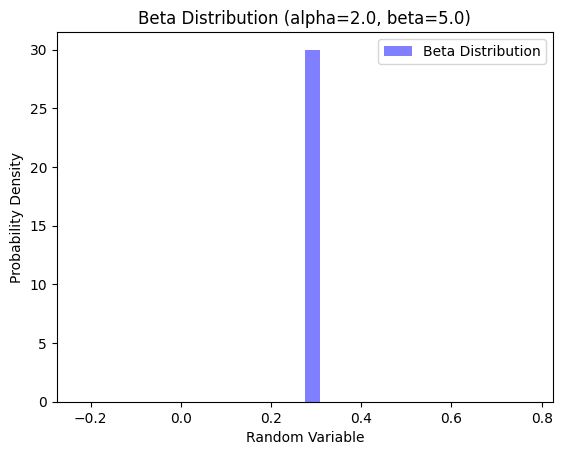

In [3]:
import numpy as np
import matplotlib.pyplot as plt

# Define the shape parameters alpha and beta
alpha = 2.0  # Shape parameter
beta = 5.0   # Shape parameter

# Number of random samples
num_samples = 1

# Generate random variables from the beta distribution
beta_samples = np.random.beta(alpha, beta, num_samples)[0]
print(beta_samples)

# Plot a histogram to visualize the distribution
plt.hist(beta_samples, bins=30, density=True, alpha=0.5, color='b', label='Beta Distribution')
plt.xlabel('Random Variable')
plt.ylabel('Probability Density')
plt.title('Beta Distribution (alpha={}, beta={})'.format(alpha, beta))
plt.legend()
plt.show()


# Functions required

In [4]:
def get_margins(mu, N, M, t, T, delta):
    delta = 0.1
    val1 = N*(M+1)/2/delta
    val2 = t**3
    val = val1*val2
    # print(val)
    log_term = math.log(val)
    sqrt_term = log_term/2/T
    alpha = math.sqrt(sqrt_term)
    LCB = mu - alpha
    UCB = mu + alpha
    return LCB, UCB

In [5]:
def get_feasible_set(mu_th, UCB_attr):
    ## mu_attr will be an array with the current means of all attributes of the specific arm
    ## same for UCB and LCB things
    feasible_set = []
    ## here mu_attr would be a 2D array with all the means
    ## same for LCB (LCB_attr)
    n = len(UCB_attr)
    m = len(UCB_attr[0])
    for i in range (n):
        ## for each arm
        found = False
        UCB_min = min(UCB_attr[i])
        if (UCB_min >= mu_th):
            feasible_set.append(i)

    return feasible_set

In [6]:
def get_perfect_feasible_set(mu_th, LCB_attr):
    feasible_set = []
    ## here mu_attr would be a 2D array with all the means
    ## same for LCB (LCB_attr)
    # n = len(LCB_attr)
    n = len(LCB_attr)
    for i in range (n):
        ## for each arm
        LCB_min  = min(LCB_attr[i])
        if (LCB_min >= mu_th):
            feasible_set.append(i)

    return feasible_set

In [7]:
def get_potential_set(i_star_t, LCB_i_star, UCB):
    ## here UCB will be an array for UCB of means of all the arms
    potent = []
    for i in range(len(UCB)):
        if ((LCB_i_star <= UCB[i]) and (i != i_star_t)):
            potent.append(i)
    return potent

In [8]:
def best_arm(mu, feasible_set):
    ## for arms in feasible set, we need to find the arm with maximum mean
    best = feasible_set[0]
    for arm in feasible_set:
        if(mu[arm] >= mu[best]):
            best = arm
    return best

In [9]:
def intersection(lst1, lst2):
    temp = set(lst2)
    lst3 = [value for value in lst1 if value in temp]
    return lst3

In [10]:
def potentially_competitor_arm(UCB, feasible_set, potentially_best_arm):
    if (potentially_best_arm != feasible_set[0]):
        best = feasible_set[0]
    else:
        best = feasible_set[1]
    for arm in feasible_set:
        if (arm != potentially_best_arm):
            if((UCB[arm] > UCB[best])):
                best = arm
    # print("pot: ", potentially_best_arm, "ct: ", best)
    return best

In [11]:
def get_suboptimal_arm(mu_i_star, mu_i, arms_set):
    suboptimal = []
    for arms in arms_set:
        if (mu_i[arms] < mu_i_star):
            suboptimal.append(arms)

    return suboptimal

In [12]:
def difference(li1, li2):
    s = set(li2)
    temp3 = [x for x in li1 if x not in s]
    return temp3

In [13]:
def get_perfect_feasible_attr_set(mu_th, LCB_attr):
    perfect_feasible = []
    for i in range (len(LCB_attr)):
        for j in range (len(LCB_attr[0])):
            if LCB_attr[i][j] >= mu_th:
                perfect_feasible.append([i, j])

    return perfect_feasible

In [14]:
def get_possibly_feasible_attr_set(mu_th, LCB_attr, UCB_attr):
    ans = []
    # N, M = len(LCB_attr), len(UCB_attr)
    # print(N, M)
    for i in range(len(LCB_attr)):
        for j in range (len(UCB_attr[0])):
            if LCB_attr[i][j] < mu_th and UCB_attr[i][j] >= mu_th:
                ans.append([i, j])
    return ans

# Oracle

In [15]:
class Oracle:
    def __init__(self, M, N, mu_th) -> None:
        self.M = M
        self.N = N
        arms = 5
        attributes = 2
        self.mu_ij = [[0 for i in range (attributes)] for j in range (arms)]
        self.ab_array = [[[0, 0] for i in range (attributes)] for j in range (arms)]
        self.mu_i = [0 for i in range (arms)]

        self.mu_th = mu_th
        
        ## fixing alpha at 1

        self.ab_array[0] = np.array([[1, 0.25], [1, (1/x) - 1]])        #0.5
        self.ab_array[1] = np.array([[1, 2.33], [1, 1]])                #0.2
        self.ab_array[2] = np.array([[1, 1.5], [1, 0.67]])              #0.3
        self.ab_array[3] = np.array([[1, 0.25], [1, 1]])                #0.4
        self.ab_array[4] = np.array([[1, 4], [1, 1.5]])                 #0.3

        for i in range (arms):
            for j in range (attributes):
                alpha = self.ab_array[i][j][0]
                beta = self.ab_array[i][j][1]
                self.mu_ij[i][j] = alpha / (alpha + beta)


        for i in range (len(self.mu_i)):
            self.mu_i[i] = sum(self.mu_ij[i])/attributes

    def play(self, arm, attr):
        alpha, beta = self.ab_array[arm][attr]
        reward = np.random.beta(alpha, beta, 1)[0]
        return reward
    
    def H_index(self):
        self.i_star = 0                 ## best arm in the feasible set
        self.i_star_star = 1            ## best arm in suboptimal set

        self.delta_i = [0 for i in range (self.N)]
        self.delta_ij = [[0 for i in range (self.M)] for j in range (self.N)]
        self.delta_i_attr = [0 for i in range (self.N)]

         ### assume that always i_star is 0 ###
        
        all_arms = list(range(0, self.N))

        self.perfect_feasible = get_perfect_feasible_set(self.mu_th, self.mu_ij)
        self.i_star = best_arm(self.mu_i, self.perfect_feasible)

        self.suboptimal = get_suboptimal_arm(self.mu_i[self.i_star], self.mu_i, all_arms)
        self.i_star_star = best_arm(self.mu_i, self.suboptimal)
        
        self.risky = difference(all_arms, self.suboptimal)
        self.infeasible = difference(all_arms, self.perfect_feasible) 

        for i in range (self.N):
            if (i != self.i_star):
                self.delta_i[i] = self.mu_i[self.i_star] - self.mu_i[i]
                self.delta_i_attr[i] = abs(min(self.mu_ij[i]) - self.mu_th)

        self.delta_i[self.i_star] = self.delta_i[self.i_star_star]
        self.delta_i_attr[self.i_star] = abs(min(self.mu_ij[self.i_star]) - self.mu_th)
        # print(self.delta_i_attr)

        self.set1 = intersection(self.perfect_feasible, self.suboptimal)
        self.set2 = intersection(self.infeasible, self.risky)
        self.set3 = intersection(self.infeasible, self.suboptimal)

        h0_den = (min(self.delta_i[self.i_star]/2, self.delta_i_attr[self.i_star]))**2
        h0 = 1/h0_den

        h1 = 0
        for i in self.set1:
            h1 += 4/(self.delta_i[i])**2

        h2 = 0
        for i in self.set2:
            h2 += 1/(self.delta_i_attr[i])**2

        h3 = 0
        for i in self.set3:
            h3 += 1/(max(self.delta_i[i]/2, self.delta_i_attr[i]))**2
            # h3 += 5*np.exp((1/(max(self.delta_i[i]/2, 2*self.delta_i_attr[i]))**2)/192)

        h_index = h0 + h1 + h2 + h3
        # print(self.delta_i_attr[1])
        # print(h0, h1, h2, h3)
        # print(self.set2)

        return h_index
    

    # def H_index_old(self):
    #     self.i_star = 0                 ## best arm in the feasible set
    #     self.i_star_star = 1            ## best arm in suboptimal set

    #     self.delta_i = [0 for i in range (self.N)]
    #     self.delta_ij = [[0 for i in range (self.M)] for j in range (self.N)]
    #     self.delta_i_attr = [0 for i in range (self.N)]

    #      ### assume that always i_star is 0 ###
    #     for i in range (1, self.N):
    #         self.delta_i[i] = self.mu_i[self.i_star] - self.mu_i[i]
    #         self.delta_i_attr[i] = abs(min(self.mu_ij[i]) - self.mu_th)

    #     self.delta_i[self.i_star] = self.delta_i[self.i_star_star]
    #     self.delta_i_attr[self.i_star] = abs(min(self.mu_ij[self.i_star]) - self.mu_th)
    #     # print(self.delta_i_attr)

    #     all_arms = list(range(0, self.N))

    #     self.perfect_feasible = get_perfect_feasible_set(self.mu_th, self.mu_ij)
    #     self.suboptimal = get_suboptimal_arm(self.mu_i[self.i_star], self.mu_i, all_arms)
    #     self.risky = difference(all_arms, self.suboptimal)
    #     self.infeasible = difference(all_arms, self.perfect_feasible)                       ######################################3

    #     self.set1 = intersection(self.perfect_feasible, self.suboptimal)
    #     self.set2 = intersection(self.infeasible, self.risky)
    #     self.set3 = intersection(self.infeasible, self.suboptimal)

    #     h0_den = (min(self.delta_i[self.i_star]/2, self.delta_i_attr[self.i_star]))**2
    #     h0 = 1/h0_den

    #     h1 = 0
    #     for i in range (len(self.set1)):
    #         h1 += 4/(self.delta_i[self.set1[i]])**2

    #     h2 = 0
    #     for i in range (len(self.set2)):
    #         h2 += 1/(self.delta_i_attr[i])**2

    #     h3 = 0
    #     for i in range (len(self.set3)):
    #         h3 += (1/(max(self.delta_i[i]/2, self.delta_i_attr[i]))**2)

    #     h_index = h0 + h1 + h2 + h3
    #     # print(self.delta_i_attr[1])

    #     return h_index

        

# Main function

In [16]:
def game(M, N, mu_th, delta):
    T_t = [[0 for i in range (M)] for j in range (N)]
    t = 1
    theGame = Oracle(M, N, mu_th)

    h_idx, h_idx_old = 0, 0
    # h_idx_old = theGame.H_index_old()
    h_idx = theGame.H_index()

    mu_hat_i = [0 for i in range (N)]
    mu_hat_ij = [[0 for i in range (M)] for j in range (N)]

    LCB = [0 for i in range (N)]
    UCB = [0 for i in range (N)]

    LCB_attr = [[0 for i in range (M)] for j in range (N)]
    UCB_attr = [[0 for i in range (M)] for j in range (N)]

    T_unif = 20

    for j in range (T_unif):
        ## 20 times uniform exploration
        for i in range (N):
            for k in range (M):
                reward_arm = theGame.play(i, k)
                mu_hat_ij[i][k] = (mu_hat_ij[i][k] * T_t[i][k] + reward_arm)/(T_t[i][k] + 1)
                T_t[i][k] += 1
            mu_hat_i[i] = sum(mu_hat_ij[i])/M
            

    all_arms = list(range(0, N))
    feasible = list(range(0, N))
    t += N*T_unif*M

    ### further pulls

    while(True):
        ## arm wise margins
        for i in range (N):
            LCB[i], UCB[i] = get_margins(mu_hat_i[i], N, M, t, sum(T_t[i]), delta)

        ## attribute wise margins
        for i in range (N):
            for j in range (M):
                LCB_attr[i][j], UCB_attr[i][j] = get_margins(mu_hat_ij[i][j], N, M, t, T_t[i][j], delta)

        perfect_feasible = get_perfect_feasible_set(mu_th, LCB_attr)
        feasible = get_feasible_set(mu_th, UCB_attr)

        perfect_feasible_attr = get_perfect_feasible_attr_set(mu_th, LCB_attr)                  ## this is the surely feasible set
        possibly_feasible_attr = get_possibly_feasible_attr_set(mu_th, LCB_attr, UCB_attr)               ## this is the dell f set
        ### here each entry will be an array with values [arm, attr]

        if(len(perfect_feasible) != 0):
            i_star_t = best_arm(mu_hat_i, perfect_feasible)

        if (len(feasible) != 0):
            i_t = best_arm(mu_hat_i, feasible)

        ## potential set is the set of arms which have more UCB than the  current best arm mean, irrespective of feasibility
        if (len(perfect_feasible) == 0):
            potential = all_arms
        else:
            potential = get_potential_set(i_star_t, LCB[i_star_t], UCB)
        
        pot_intersect_feas = intersection(potential, feasible)

        print("Feasible: ", feasible, "Perfect feasible: ", perfect_feasible, "Potential: ", potential, "mu_hat for all", mu_hat_i, "UCB of all: ", UCB, "LCB for all: ", LCB)
        #  "i_t: ", i_t, "i_star: ", i_star_t,

        ## Stopping criteria
        if (len(pot_intersect_feas) == 0):
            if(len(perfect_feasible) == 0):
                f_hat = 0
                i_out = N
            else:
                f_hat = 1
                i_out = i_t
            return i_out, f_hat, t, h_idx_old, h_idx
        
        if (len(feasible) == 1):
            i_t = best_arm(mu_hat_i, feasible)
            for arm, attr in possibly_feasible_attr:
                if arm == i_t:
                    ### pull arm, attr
                    reward = theGame.play(arm, attr)
                    mu_hat_ij[arm][attr] = (mu_hat_ij[arm][attr] * T_t[arm][attr] + reward)/(T_t[arm][attr] + 1)
                    T_t[arm][attr] += 1
                    t += 1
            mu_hat_i[i_t] = sum(mu_hat_ij[i_t])/M
        else:
            i_t = best_arm(mu_hat_i, feasible)
            c_t = potentially_competitor_arm(UCB, feasible, i_t)
            for arm, attr in possibly_feasible_attr:
                if arm == i_t or arm == c_t:
                    ### pull arm, attr
                    reward = theGame.play(arm, attr)
                    mu_hat_ij[arm][attr] = (mu_hat_ij[arm][attr] * T_t[arm][attr] + reward)/(T_t[arm][attr] + 1)
                    T_t[arm][attr] += 1
                    t += 1

            mu_hat_i[i_t] = sum(mu_hat_ij[i_t])/M
            mu_hat_i[c_t] = sum(mu_hat_ij[c_t])/M


# Tests

## Single instance

Base Case: with 5 arms

In [25]:
# self.mu_ij[0] = np.array([0.9, 0.1])        #0.5
#         self.mu_ij[1] = np.array([0.1, 0.3])        #0.2
#         self.mu_ij[2] = np.array([0.2, 0.4])        #0.3
#         self.mu_ij[3] = np.array([0.4, 0.4])        #0.4
#         self.mu_ij[4] = np.array([0.5, 0.1])        #0.3

# self.ab_array[0] = np.array([[1, 0.11], [1, 9]])            #0.5
# self.ab_array[1] = np.array([[1, 9], [1, 2.33]])            #0.2
# self.ab_array[2] = np.array([[1, 4], [1, 1.5]])             #0.3
# self.ab_array[3] = np.array([[1, 1.5], [1, 1.5]])           #0.4
# self.ab_array[4] = np.array([[1, 1], [1, 9]])               #0.3

# mu_th = 0.3

In [17]:
N = 5
M = 2
x = 0.9
best_arm_identified = []
N_iter = 1
count = [0 for i in range (N+1)]
samples_all = []
for i in range (N_iter):
    best_arm_guess, f, samples, h_idx_old, h_idx = game(M, N, mu_th=0.4, delta=0.1)
    samples_all.append(samples)
    best_arm_identified.append(best_arm_guess)
    count[best_arm_guess] += 1
    print(count)


Feasible:  [0, 1, 2, 3, 4] Perfect feasible:  [] Potential:  [0, 1, 2, 3, 4] mu_hat for all [0.8643286333491504, 0.45607243980650103, 0.5712773519362249, 0.6412258531737909, 0.3197104604607347] UCB of all:  [1.3671631344242252, 0.9589069408815757, 1.0741118530112996, 1.1440603542488654, 0.8225449615358094] LCB for all:  [0.3614941322740758, -0.04676206126857363, 0.0684428508611502, 0.13839135209871622, -0.18312404061433996]
Feasible:  [0, 1, 2, 3, 4] Perfect feasible:  [] Potential:  [0, 1, 2, 3, 4] mu_hat for all [0.8634113158094123, 0.45607243980650103, 0.5712773519362249, 0.6134966152634043, 0.3197104604607347] UCB of all:  [1.3548440856500412, 0.959641179540109, 1.0748460916698328, 1.1049293851040332, 0.8232792001943426] LCB for all:  [0.3719785459687834, -0.04749629992710691, 0.06770861220261692, 0.12206384542277532, -0.18385827927287324]
Feasible:  [0, 1, 2, 3, 4] Perfect feasible:  [] Potential:  [0, 1, 2, 3, 4] mu_hat for all [0.8683762003804538, 0.45607243980650103, 0.57127735

: 

In [22]:
print(h_idx_old, h_idx)

0 575.0000000000002


## Multiple Instances

#### Case 1a

In [23]:
# self.mu_ij[0] = np.array([x, 0.6])          #0.575 to 0.75
# self.mu_ij[1] = np.array([0.5, 0.6])        #0.55
# self.mu_ij[2] = np.array([0.2, 0.8])        #0.5
# self.mu_ij[3] = np.array([0.4, 0.5])        #0.45
# self.mu_ij[4] = np.array([0.5, 0.3])        #0.4

# self.ab_array[0] = np.array([[1, (1/x) - 1], [1, 0.66]])        #0.5
# self.ab_array[1] = np.array([[1, 1], [1, 0.66]])                #0.2
# self.ab_array[2] = np.array([[1, 4], [1, 0.25]])                #0.3
# self.ab_array[3] = np.array([[1, 1.5], [1, 1]])                 #0.4
# self.ab_array[4] = np.array([[1, 1], [1, 2.33]])                #0.3

# mu_th = 0.3
# x from 0.55 to 0.9

In [43]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound = []
prob_success = []

# for x in [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]:
for x in [0.85, 0.9]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_idx_old, h_idx = game(M, N, mu_th=0.3, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    time = h_idx * math.log(h_idx/delta_ins)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


KeyboardInterrupt: 

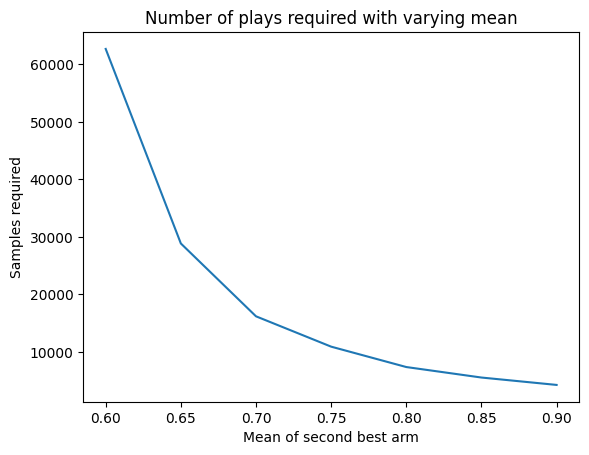

In [22]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

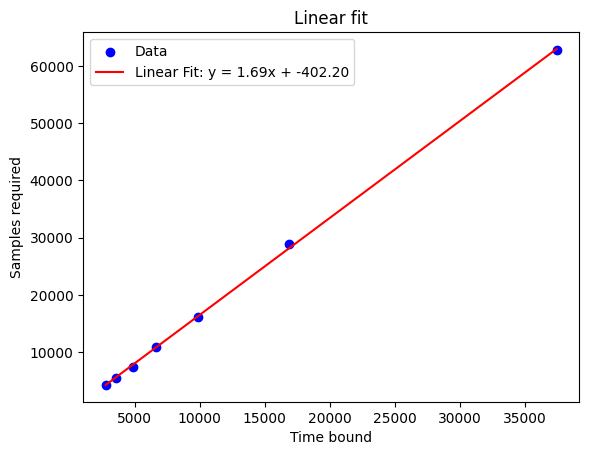

In [23]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()

In [24]:
print(prob_success)

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


#### Case 1b

In [ ]:
# self.mu_ij[0] = np.array([x, 1])            #0.75 to 0.85
# self.mu_ij[1] = np.array([0.4, 0.4])        #0.4
# self.mu_ij[2] = np.array([0.2, 0.4])        #0.3
# self.mu_ij[3] = np.array([0.1, 0.5])        #0.3
# self.mu_ij[4] = np.array([0.5, 0.3])        #0.4

# self.ab_array[0] = np.array([[1, (1/x) - 1], [1, 0.01]])        #0.75 to 0.85
# self.ab_array[1] = np.array([[1, 1.5], [1, 1.5]])            #0.4
# self.ab_array[2] = np.array([[1, 4], [1, 1.5]])              #0.3
# self.ab_array[3] = np.array([[1, 9], [1, 1]])                #0.3
# self.ab_array[4] = np.array([[1, 1], [1, 2.33]])             #0.4

# mu_th = 0.45
# x from 0.5 to 0.7
# x, 1.5-x

# self.delta_i[self.i_star]/2 > self.delta_i_attr[self.i_star]
# Basic problem to be addressed is feasibility

In [26]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound = []
prob_success = []

for x in [0.5, 0.55, 0.6, 0.65, 0.7]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_idx_old, h_idx = game(M, N, mu_th=0.45, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    time = h_idx * math.log(h_idx/delta_ins)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


Done
Done
Done
Done
Done


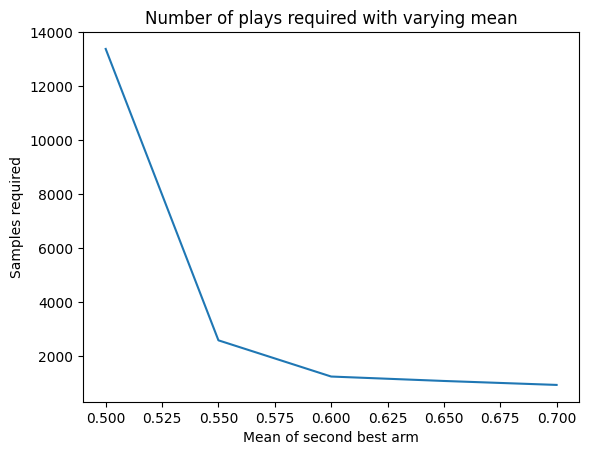

In [27]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

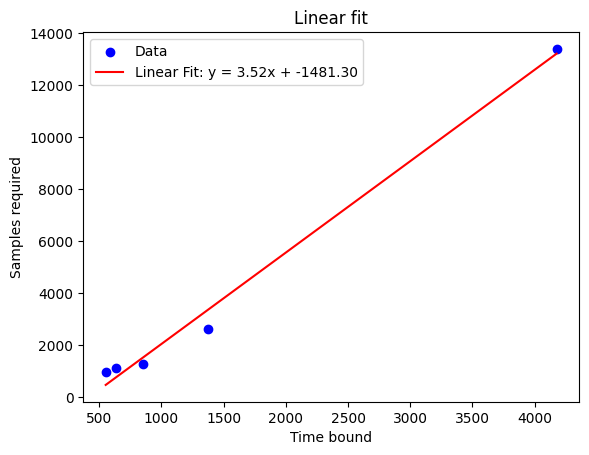

In [28]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()

In [29]:
print(prob_success)

[1.0, 1.0, 1.0, 1.0, 1.0]


#### Case 2

In [ ]:
# self.mu_ij[0] = np.array([x, 0.8])        #0.7 to 0.85 - feasible and best
#         self.mu_ij[1] = np.array([0.3, 1])        #0.65 - infeasible
#         self.mu_ij[2] = np.array([0.5, 0.6])        #0.55
#         self.mu_ij[3] = np.array([0.4, 0.5])        #0.45
#         self.mu_ij[4] = np.array([0.1, 0.5])        #0.3 - infeasible

# self.ab_array[0] = np.array([[1, (1/x) - 1], [1, 0.25]])      #0.5
# self.ab_array[1] = np.array([[1, 2.33], [1, 0.01]])           #0.2
# self.ab_array[2] = np.array([[1, 1], [1, 0.67]])              #0.3
# self.ab_array[3] = np.array([[1, 1.5], [1, 1]])               #0.4
# self.ab_array[4] = np.array([[1, 9], [1, 1]])                 #0.3

# mu_th = 0.4

# delta i of arms in set (feasible intersection suboptimal)
# As delta_i increases, sample complexity will decrease

# let 3 arms be feasible
# one of the infeasible arm has highest total mean - this wont be suboptimal - not having this case
# total 3 suboptimal arms
# increase the mean of best arm -> delta_i will increase for all the arms
# vary x from 0.6 to 0.9


In [31]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound, time_bound_old = [], []
prob_success = []

for x in [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_id_old, h_id = game(M, N, mu_th=0.4, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    # time_old = h_id_old * math.log(h_id_old/delta_ins)
    time = h_id * math.log(h_id/delta_ins)
    # time_bound_old.append(time_old)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


Done
Done
Done
Done
Done
Done
Done


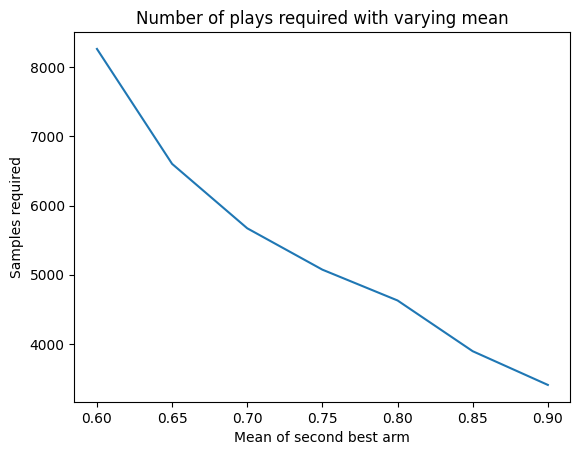

In [32]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

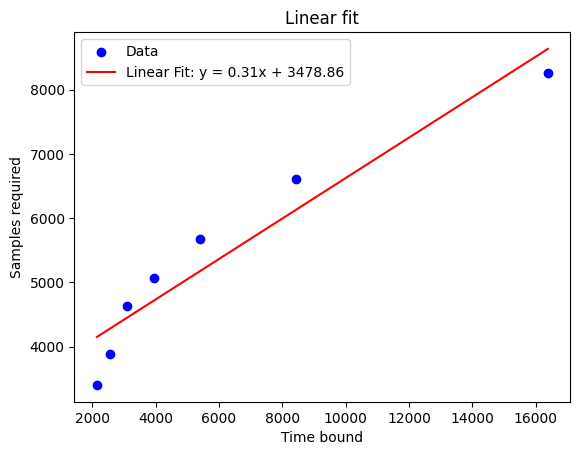

In [33]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()

In [ ]:
print(prob_success)

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


#### Case 3

In [ ]:
# self.mu_ij[0] = np.array([0.55, 0.6])        #0.575
#         self.mu_ij[1] = np.array([0.4, 0.6])        #0.5
#         self.mu_ij[2] = np.array([x, 1])        #0.6 to 0.725- risky and infeasible
#         self.mu_ij[3] = np.array([0.4, 0.5])        #0.45
#         self.mu_ij[4] = np.array([0.1, 0.5])        #0.3 - infeasible

# self.ab_array[0] = np.array([[1, 0.82], [1, 0.67]])           #0.5
# self.ab_array[1] = np.array([[1, 1.5], [1, 0.67]])            #0.3
# self.ab_array[2] = np.array([[1, (1/x) - 1], [1, 0.01]])      #0.2
# self.ab_array[3] = np.array([[1, 1.5], [1, 1]])               #0.4
# self.ab_array[4] = np.array([[1, 9], [1, 1]])                 #0.3

# mu_th = 0.5

# delta_i_attr of arms in set (infeasible intersection risky)
# As delta_i_attr increases, sample complexity will decrease
# risky - mean greater than the best arm, would be infeasible most probably

# as x increases, delta_i_attr decreases, h2 increases
# as x increases, 

# x, 1.2 - x, x varying from 0

In [37]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound = []
prob_success = []

for x in [0.2, 0.25, 0.3, 0.35, 0.4, 0.45]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_idx_old, h_idx = game(M, N, mu_th=0.5, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    time = h_idx * math.log(h_idx/delta_ins)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


Done
Done
Done
Done
Done
Done


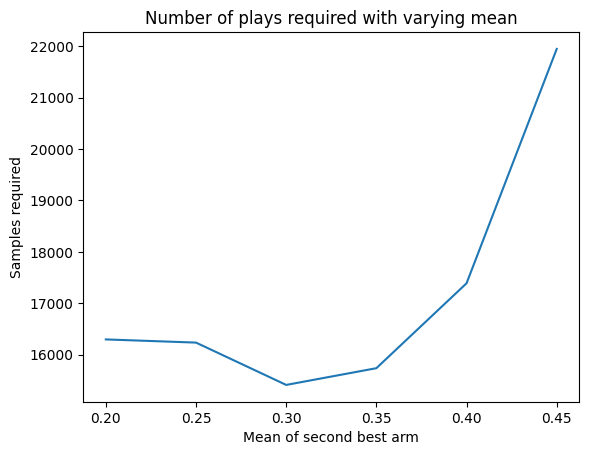

In [38]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

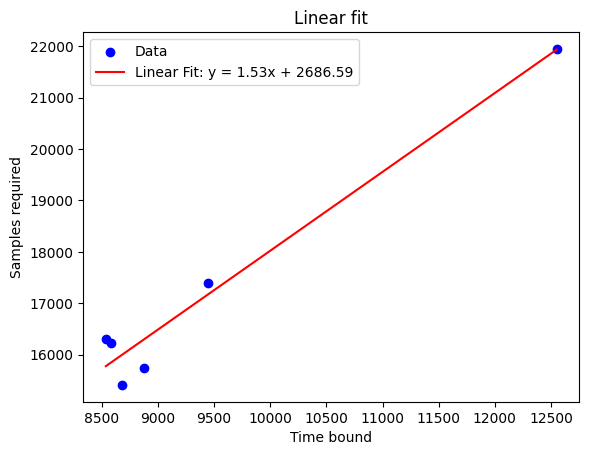

In [39]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()

In [64]:
print(time_bound)
print(samples_ins)

[8535.750322071997, 8585.34499568259, 8676.710773309305, 8874.396750451418, 9441.342230885399, 12551.389025121716]
[9821.4, 10286.0, 9978.2, 10970.2, 11418.6, 18723.0]


In [65]:
print(prob_success)

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


#### Case 4a

In [ ]:
# self.mu_ij[0] = np.array([0.8, x])        #0.7 to 0.85
#         self.mu_ij[1] = np.array([0.3, 0.5])        #0.4 - infeasible
#         self.mu_ij[2] = np.array([0.4, 0.6])        #0.5 - infeasible
#         self.mu_ij[3] = np.array([0.8, 0.5])        #0.65
#         self.mu_ij[4] = np.array([0.2, 0.4])        #0.3 - infeasible

# self.ab_array[0] = np.array([[1, 0.25], [1, (1/x) - 1]])        #0.5
# self.ab_array[1] = np.array([[1, 2.33], [1, 1]])                #0.2
# self.ab_array[2] = np.array([[1, 1.5], [1, 0.67]])              #0.3
# self.ab_array[3] = np.array([[1, 0.25], [1, 1]])                #0.4
# self.ab_array[4] = np.array([[1, 4], [1, 1.5]])                 #0.3

# mu_th = 0.4

# arms in set (infeasible intersection suboptimal)
# max(delta_i/2, delta_i_attr)
# delta_i/2 > delta_i_attr

# 3 arms infeasible, out of them one will be risky, 2 will be suboptimal
# x varies from 0.6 to 0.9

In [2]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound, time_bound_old = [], []
prob_success = []

for x in [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_id_old, h_id = game(M, N, mu_th=0.4, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    # time_old = h_id_old * math.log(h_id_old/delta_ins)
    time = h_id * math.log(h_id/delta_ins)
    # time_bound_old.append(time_old)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


NameError: name 'game' is not defined

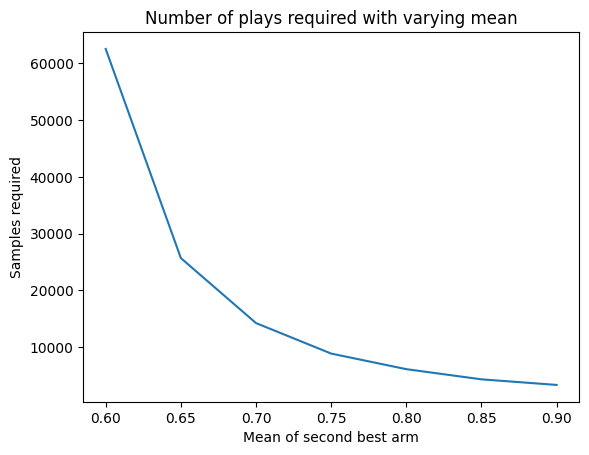

In [43]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

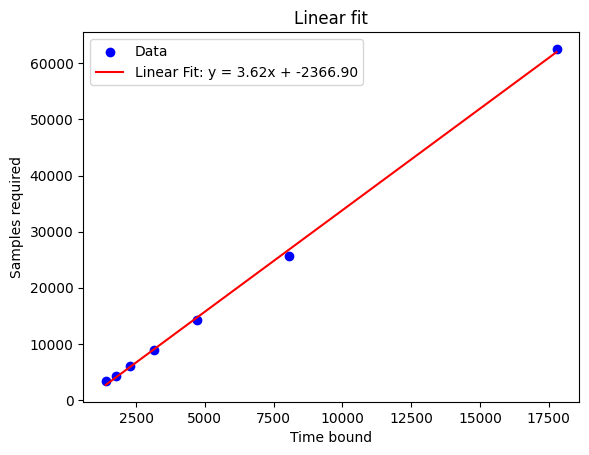

In [44]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()

In [45]:
print(prob_success)

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


#### Case 4b

In [ ]:
# self.mu_ij[0] = np.array([0.5, 0.7])        #0.6
#         self.mu_ij[1] = np.array([x, 0.8])        #0.5 - infeasible
#         self.mu_ij[2] = np.array([0.3, 0.5])        #0.4 - infeasible
#         self.mu_ij[3] = np.array([0.5, 0.5])        #0.5
#         self.mu_ij[4] = np.array([0.2, 0.4])        #0.3 - infeasible

# self.ab_array[0] = np.array([[1, 1], [1, 0.43]])               #0.5
# self.ab_array[1] = np.array([[1, (1/x) - 1], [1, 0.25]])       #0.2
# self.ab_array[2] = np.array([[1, 2.33], [1, 1]])               #0.3
# self.ab_array[3] = np.array([[1, 1], [1, 1]])                  #0.4
# self.ab_array[4] = np.array([[1, 4], [1, 1.5]])                #0.3

# mu_th = 0.4

# arms in set (infeasible intersection suboptimal)
# max(delta_i/2, delta_i_attr)
# delta_i/2 < delta_i_attr

# 3 arms infeasible, all of them suboptimal
# x, 1-x, x varying from 0.35 to 0.1
# x = 0.1,0.8 mean = 0.45, delta_i/2 = 0.075
# x = 0.3,0.8 mean = 0.55, delta_i/2 = 0.025
# x = 0.35, 0.8, mean = 0.575, delta_i/2 = 0.0125



In [47]:
N = 5
M = 2
N_iter = 10
delta_ins = 0.1

samples_ins = []
x_val = []
time_bound, time_bound_old = [], []
prob_success = []

for x in [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]:
    count = [0 for i in range (N+1)]
    samples_all = []
    for i in range (N_iter):
        best_arm_guess, f, samples, h_id_old, h_id = game(M, N, mu_th=0.4, delta=delta_ins)
        samples_all.append(samples)
        count[best_arm_guess] += 1

    samples_ins.append(sum(samples_all)/N_iter)
    x_val.append(x)
    # time_old = h_id_old * math.log(h_id_old/delta_ins)
    time = h_id * math.log(h_id/delta_ins)
    # time_bound_old.append(time_old)
    time_bound.append(time)
    prob_success.append(count[0]/N_iter)
    print("Done")


Done
Done
Done
Done
Done
Done
Done


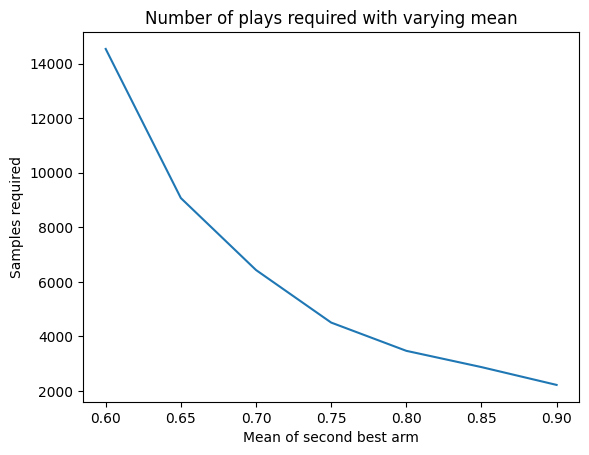

In [48]:
plt.title("Number of plays required with varying mean")
plt.xlabel("Mean of second best arm")
plt.ylabel("Samples required")
plt.plot(x_val, samples_ins)
plt.show()

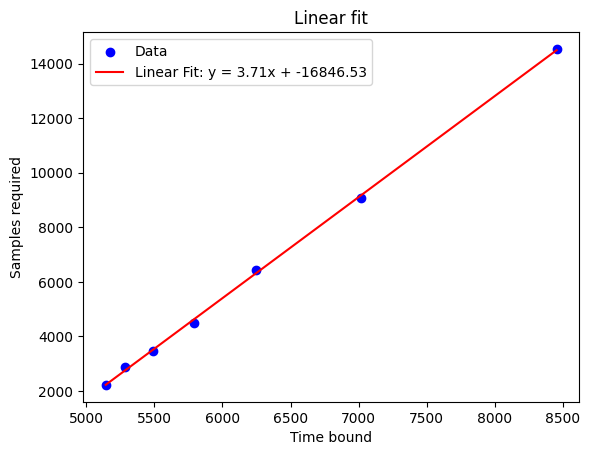

In [49]:
slope, intercept = np.polyfit(time_bound, samples_ins, 1)
time_bound_arr = np.array(time_bound)
regression_line = slope * time_bound_arr + intercept
plt.scatter(time_bound, samples_ins, label='Data', color='blue')
plt.plot(time_bound_arr, regression_line, label=f'Linear Fit: y = {slope:.2f}x + {intercept:.2f}', color='red')
plt.xlabel("Time bound")
plt.ylabel("Samples required")
plt.legend()
plt.title("Linear fit")
plt.show()